<a href="https://colab.research.google.com/github/sgwhat/analytics-zoo/blob/master/pyzoo/zoo/examples/orca/learn/pytorch/fashion_mnist/fashion_mnist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install jdk8
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
import os
# Set environment variable JAVA_HOME.
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
!update-alternatives --set java /usr/lib/jvm/java-8-openjdk-amd64/jre/bin/java
!java -version

openjdk version "1.8.0_292"
OpenJDK Runtime Environment (build 1.8.0_292-8u292-b10-0ubuntu1~18.04-b10)
OpenJDK 64-Bit Server VM (build 25.292-b10, mixed mode)


In [ ]:
import sys

# Get current python version
version_info = sys.version_info
python_version = f"{version_info.major}.{version_info.minor}.{version_info.micro}"

In [ ]:
# Install Miniconda
!wget https://repo.continuum.io/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
!chmod +x Miniconda3-4.5.4-Linux-x86_64.sh
!./Miniconda3-4.5.4-Linux-x86_64.sh -b -f -p /usr/local

# Update Conda
!conda install --channel defaults conda python=$python_version --yes
!conda update --channel defaults --all --yes

# Append to the sys.path
_ = (sys.path
        .append(f"/usr/local/lib/python{version_info.major}.{version_info.minor}/site-packages"))

os.environ['PYTHONHOME']="/usr/local"

--2021-06-30 12:31:14--  https://repo.continuum.io/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.continuum.io (repo.continuum.io)... 104.18.200.79, 104.18.201.79, 2606:4700::6812:c94f, ...
Connecting to repo.continuum.io (repo.continuum.io)|104.18.200.79|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh [following]
--2021-06-30 12:31:14--  https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.131.3, 104.16.130.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.131.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 58468498 (56M) [application/x-sh]
Saving to: ‘Miniconda3-4.5.4-Linux-x86_64.sh.2’

Miniconda3-4.5.4-Li 100%[===================>]  55.76M   126MB/s    in 0.4s    

2021-06-30 12:31:15 (126 MB/s) - ‘Miniconda3-4.5.4-Linux-x8

In [ ]:
# Install latest pre-release version of Analytics Zoo 
# Installing Analytics Zoo from pip will automatically install pyspark, bigdl, and their dependencies.
!pip install --pre --upgrade analytics-zoo[ray]

  Using cached ray-1.2.0-cp37-cp37m-manylinux2014_x86_64.whl (47.5 MB)
  Using cached chardet-3.0.4-py2.py3-none-any.whl (133 kB)
  Attempting uninstall: chardet
    Found existing installation: chardet 4.0.0
    Uninstalling chardet-4.0.0:
      Successfully uninstalled chardet-4.0.0
  Attempting uninstall: ray
    Found existing installation: ray 1.4.0
    Uninstalling ray-1.4.0:
      Successfully uninstalled ray-1.4.0


In [ ]:
# Install python dependencies
!pip install torch==1.7.1 torchvision==0.8.2

In [ ]:
!pip install -U ray

  Using cached ray-1.4.0-cp37-cp37m-manylinux2014_x86_64.whl (49.4 MB)
  Attempting uninstall: ray
    Found existing installation: ray 1.2.0
    Uninstalling ray-1.2.0:
      Successfully uninstalled ray-1.2.0


In [ ]:
!pip install jep==3.9.0
!pip install six cloudpickle
!pip install argparse
!pip install tensorboard

  Using cached argparse-1.4.0-py2.py3-none-any.whl (23 kB)


In [ ]:
from __future__ import print_function
import argparse
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter

In [ ]:
from zoo.orca import init_orca_context, stop_orca_context
from zoo.orca.learn.pytorch import Estimator
from zoo.orca.learn.metrics import Accuracy
from zoo.orca.learn.trigger import EveryEpoch
from zoo.orca import OrcaContext

Prepending /usr/local/lib/python3.7/site-packages/bigdl/share/conf/spark-bigdl.conf to sys.path
Adding /usr/local/lib/python3.7/site-packages/zoo/share/lib/analytics-zoo-bigdl_0.12.2-spark_2.4.3-0.11.0-SNAPSHOT-jar-with-dependencies.jar to BIGDL_JARS
Prepending /usr/local/lib/python3.7/site-packages/zoo/share/conf/spark-analytics-zoo.conf to sys.path


In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
def train_data_creator(config, batch_size):
    transform = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((0.5,), (0.5,))])

    trainset = torchvision.datasets.FashionMNIST('./data',
                            download=True,
                            train=True,
                            transform=transform)
    trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                          shuffle=True, num_workers=2)
    return trainloader

In [ ]:
def validation_data_creator(config, batch_size):
    transform = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((0.5,), (0.5,))])
    testset = torchvision.datasets.FashionMNIST(root='./data', train=False,
                           download=True, transform=transform)
    testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size, 
                          shuffle=False, num_workers=2)
    return testloader

In [ ]:
# helper function to show an image
def matplotlib_imshow(img, one_channel=False):
    if one_channel:
        img = img.mean(dim=0)
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    if one_channel:
        plt.imshow(npimg, cmap="Greys")
    else:
        plt.imshow(np.transpose(npimg, (1, 2, 0)))

In [ ]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16 * 4 * 4, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 16 * 4 * 4)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


In [ ]:
def model_creator(config):
    model = Net()
    return model

def optimizer_creator(model, config):
    optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    return optimizer

In [ ]:
import argparse

parser = argparse.ArgumentParser(description='PyTorch Tensorboard Example')
parser.add_argument('--cluster_mode', type=str, default="local",
                    help='The cluster mode, such as local, yarn or k8s.')
parser.add_argument('--backend', type=str, default="bigdl",
                    help='The backend of PyTorch Estimator; '
                     'bigdl and torch_distributed are supported.')
args = parser.parse_args(args=[])
print(args)

Namespace(backend='bigdl', cluster_mode='local')


In [ ]:
OrcaContext.log_output = True # (this will display terminal's stdout and stderr in the Jupyter notebook).

cluster_mode = "local"

if args.cluster_mode == "local":
    init_orca_context(cores=1, memory="2g") # run in local mode
elif args.cluster_mode == "k8s":
    init_orca_context(cluster_mode="k8s", num_nodes=2, cores=4) # run on K8s cluster
elif args.cluster_mode == "yarn":
    init_orca_context(cluster_mode=args.cluster_mode, cores=4, num_nodes=2)

Initializing orca context
Current pyspark location is : /usr/local/lib/python3.7/site-packages/pyspark/__init__.py
Start to getOrCreate SparkContext
pyspark_submit_args is:  --driver-class-path /usr/local/lib/python3.7/site-packages/zoo/share/lib/analytics-zoo-bigdl_0.12.2-spark_2.4.3-0.11.0-SNAPSHOT-jar-with-dependencies.jar:/usr/local/lib/python3.7/site-packages/bigdl/share/lib/bigdl-0.12.2-jar-with-dependencies.jar pyspark-shell 
2021-06-30 12:32:29 WARN  NativeCodeLoader:62 - Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


SLF4J: Class path contains multiple SLF4J bindings.
SLF4J: Found binding in [jar:file:/usr/local/lib/python3.7/site-packages/zoo/share/lib/analytics-zoo-bigdl_0.12.2-spark_2.4.3-0.11.0-SNAPSHOT-jar-with-dependencies.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: Found binding in [jar:file:/usr/local/lib/python3.7/site-packages/pyspark/jars/slf4j-log4j12-1.7.16.jar!/org/slf4j/impl/StaticLoggerBinder.class]
SLF4J: See http://www.slf4j.org/codes.html#multiple_bindings for an explanation.
SLF4J: Actual binding is of type [org.slf4j.impl.Log4jLoggerFactory]
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).


cls.getname: com.intel.analytics.bigdl.python.api.Sample
BigDLBasePickler registering: bigdl.util.common  Sample
cls.getname: com.intel.analytics.bigdl.python.api.EvaluatedResult
BigDLBasePickler registering: bigdl.util.common  EvaluatedResult
cls.getname: com.intel.analytics.bigdl.python.api.JTensor
BigDLBasePickler registering: bigdl.util.common  JTensor
cls.getname: com.intel.analytics.bigdl.python.api.JActivity
BigDLBasePickler registering: bigdl.util.common  JActivity
Successfully got a SparkContext



User settings:

   KMP_AFFINITY=granularity=fine,compact,1,0
   KMP_BLOCKTIME=0
   KMP_SETTINGS=1
   OMP_NUM_THREADS=1

Effective settings:

   KMP_ABORT_DELAY=0
   KMP_ADAPTIVE_LOCK_PROPS='1,1024'
   KMP_ALIGN_ALLOC=64
   KMP_ALL_THREADPRIVATE=128
   KMP_ATOMIC_MODE=2
   KMP_BLOCKTIME=0
   KMP_CPUINFO_FILE: value is not defined
   KMP_DETERMINISTIC_REDUCTION=false
   KMP_DEVICE_THREAD_LIMIT=2147483647
   KMP_DISP_HAND_THREAD=false
   KMP_DISP_NUM_BUFFERS=7
   KMP_DUPLICATE_LIB_OK=false
   KMP_FORCE_REDUCTION: value is not defined
   KMP_FOREIGN_THREADS_THREADPRIVATE=true
   KMP_FORKJOIN_BARRIER='2,2'
   KMP_FORKJOIN_BARRIER_PATTERN='hyper,hyper'
   KMP_FORKJOIN_FRAMES=true
   KMP_FORKJOIN_FRAMES_MODE=3
   KMP_GTID_MODE=3
   KMP_HANDLE_SIGNALS=false
   KMP_HOT_TEAMS_MAX_LEVEL=1
   KMP_HOT_TEAMS_MODE=0
   KMP_INIT_AT_FORK=true
   KMP_ITT_PREPARE_DELAY=0
   KMP_LIBRARY=throughput
   KMP_LOCK_KIND=queuing
   KMP_MALLOC_POOL_INCR=1M
   KMP_MWAIT_HINTS=0
   KMP_NUM_LOCKS_IN_BLOCK=1
   KMP_

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode

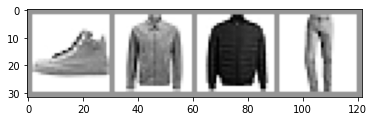

In [ ]:
tensorboard_dir = "runs"
writer = SummaryWriter(tensorboard_dir + '/fashion_mnist_experiment_1')
# constant for classes
classes = ('T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle Boot')

# plot some random training images
dataiter = iter(train_data_creator(config={}, batch_size=4))
images, labels = dataiter.next()

# create grid of images
img_grid = torchvision.utils.make_grid(images)

# show images
matplotlib_imshow(img_grid, one_channel=True)

# write to tensorboard
writer.add_image('four_fashion_mnist_images', img_grid)

# inspect the model using tensorboard
writer.add_graph(model_creator(config={}), images)
writer.close()

In [ ]:
# training loss vs. epochs
criterion = nn.CrossEntropyLoss()
batch_size = 4
epochs = 5

In [ ]:
if args.backend == "bigdl":
  train_loader = train_data_creator(config={}, batch_size=batch_size)
  test_loader = validation_data_creator(config={}, batch_size=batch_size)
  net = model_creator(config={})
  optimizer = optimizer_creator(model=net, config={"lr": 0.001})
  orca_estimator = Estimator.from_torch(model=net,
                                        optimizer=optimizer,
                                        loss=criterion,
                                        metrics=[Accuracy()],
                                        backend="bigdl")
  orca_estimator.set_tensorboard(tensorboard_dir, "bigdl")
  orca_estimator.fit(data=train_loader, epochs=epochs, validation_data=test_loader,
                       checkpoint_trigger=EveryEpoch())
  res = orca_estimator.evaluate(data=test_loader)
  print("Accuracy of the network on the test images: %s" % res)
elif args.backend == "torch_distributed":
  orca_estimator = Estimator.from_torch(model=model_creator,
                                        optimizer=optimizer_creator,
                                        loss=criterion,
                                        metrics=[Accuracy()],
                                        backend="torch_distributed")
  stats = orca_estimator.fit(train_data_creator, epochs=epochs, batch_size=batch_size)
  for stat in stats:
    writer.add_scalar("training_loss", stat['train_loss'], stat['epoch'])
  print("Train stats: {}".format(stats))
  val_stats = orca_estimator.evaluate(validation_data_creator, batch_size=batch_size)
  print("Validation stats: {}".format(val_stats))
  orca_estimator.shutdown()
else:
  raise NotImplementedError("Only bigdl and torch_distributed are supported "
  "as the backend, but got {}".format(args.backend))

creating: createTorchLoss
creating: createTorchOptim
creating: createZooKerasAccuracy
creating: createEstimator
creating: createEveryEpoch
creating: createMaxEpoch


2021-06-30 13:33:30 INFO  DistriOptimizer$:818 - caching training rdd ...


2021-06-30 13:34:11 INFO  DistriOptimizer$:649 - Cache thread models...
2021-06-30 13:34:11 WARN  DistriOptimizer$:604 - Partitions of the training data are not evenlydistributed across the executors in the Spark cluster; are there sufficient trainingdata to be distributed?
2021-06-30 13:34:11 INFO  DistriOptimizer$:632 - model thread pool size is 1
2021-06-30 13:34:11 INFO  DistriOptimizer$:651 - Cache thread models... done
2021-06-30 13:34:11 INFO  DistriOptimizer$:161 - Count dataset


[Stage 150026:>                                                     (0 + 1) / 1]

2021-06-30 13:34:30 INFO  DistriOptimizer$:165 - Count dataset complete. Time elapsed: 18.542286638s


[Stage 150027:>                                                     (0 + 1) / 1]

2021-06-30 13:34:48 WARN  DistriOptimizer$:167 - If the dataset is built directly from RDD[Minibatch], the data in each minibatch is fixed, and a single minibatch is randomly selected in each partition. If the dataset is transformed from RDD[Sample], each minibatch will be constructed on the fly from random samples, which is better for convergence.
2021-06-30 13:34:48 INFO  DistriOptimizer$:173 - config  {
	computeThresholdbatchSize: 100
	maxDropPercentage: 0.0
	warmupIterationNum: 200
	isLayerwiseScaled: false
	dropPercentage: 0.0
 }
2021-06-30 13:34:48 INFO  DistriOptimizer$:177 - Shuffle data
2021-06-30 13:34:48 INFO  DistriOptimizer$:180 - Shuffle data complete. Takes 2.52423E-4s
2021-06-30 13:34:48 INFO  DistriOptimizer$:427 - [Epoch 1 4/60000][Iteration 1][Wall Clock 0.098156825s] Trained 4.0 records in 0.098156825 seconds. Throughput is 40.751114 records/second. Loss is 2.3387246. 
2021-06-30 13:34:48 INFO  DistriOptimizer$:427 - [Epoch 1 8/60000][Iteration 2][Wall Clock 0.12948

流式输出内容被截断，只能显示最后 5000 行内容。
2021-06-30 13:39:41 INFO  DistriOptimizer$:427 - [Epoch 1 40012/60000][Iteration 10003][Wall Clock 286.475437566s] Trained 4.0 records in 0.02608696 seconds. Throughput is 153.33331 records/second. Loss is 0.028693499. 
2021-06-30 13:39:41 INFO  DistriOptimizer$:427 - [Epoch 1 40016/60000][Iteration 10004][Wall Clock 286.501284508s] Trained 4.0 records in 0.025846942 seconds. Throughput is 154.75719 records/second. Loss is 7.888595E-4. 
2021-06-30 13:39:42 INFO  DistriOptimizer$:427 - [Epoch 1 40020/60000][Iteration 10005][Wall Clock 286.525843591s] Trained 4.0 records in 0.024559083 seconds. Throughput is 162.87253 records/second. Loss is 0.4530371. 
2021-06-30 13:39:42 INFO  DistriOptimizer$:427 - [Epoch 1 40024/60000][Iteration 10006][Wall Clock 286.551263622s] Trained 4.0 records in 0.025420031 seconds. Throughput is 157.35622 records/second. Loss is 0.6243334. 
2021-06-30 13:39:42 INFO  DistriOptimizer$:427 - [Epoch 1 40028/60000][Iteration 10007][Wall C

流式输出内容被截断，只能显示最后 5000 行内容。
2021-06-30 13:47:16 INFO  DistriOptimizer$:427 - [Epoch 2 40012/60000][Iteration 25003][Wall Clock 733.16979549s] Trained 4.0 records in 0.022429315 seconds. Throughput is 178.33803 records/second. Loss is 0.23525749. 
2021-06-30 13:47:16 INFO  DistriOptimizer$:427 - [Epoch 2 40016/60000][Iteration 25004][Wall Clock 733.193262293s] Trained 4.0 records in 0.023466803 seconds. Throughput is 170.45355 records/second. Loss is 0.18722762. 
2021-06-30 13:47:16 INFO  DistriOptimizer$:427 - [Epoch 2 40020/60000][Iteration 25005][Wall Clock 733.217656062s] Trained 4.0 records in 0.024393769 seconds. Throughput is 163.9763 records/second. Loss is 0.8525465. 
2021-06-30 13:47:16 INFO  DistriOptimizer$:427 - [Epoch 2 40024/60000][Iteration 25006][Wall Clock 733.240554055s] Trained 4.0 records in 0.022897993 seconds. Throughput is 174.6878 records/second. Loss is 0.13624817. 
2021-06-30 13:47:16 INFO  DistriOptimizer$:427 - [Epoch 2 40028/60000][Iteration 25007][Wall Cloc

流式输出内容被截断，只能显示最后 5000 行内容。
2021-06-30 13:55:05 INFO  DistriOptimizer$:427 - [Epoch 3 40012/60000][Iteration 40003][Wall Clock 1202.125439699s] Trained 4.0 records in 0.022089636 seconds. Throughput is 181.0804 records/second. Loss is 0.12279971. 
2021-06-30 13:55:05 INFO  DistriOptimizer$:427 - [Epoch 3 40016/60000][Iteration 40004][Wall Clock 1202.149073018s] Trained 4.0 records in 0.023633319 seconds. Throughput is 169.25256 records/second. Loss is 0.17218558. 
2021-06-30 13:55:05 INFO  DistriOptimizer$:427 - [Epoch 3 40020/60000][Iteration 40005][Wall Clock 1202.172019225s] Trained 4.0 records in 0.022946207 seconds. Throughput is 174.32076 records/second. Loss is 0.41013452. 
2021-06-30 13:55:05 INFO  DistriOptimizer$:427 - [Epoch 3 40024/60000][Iteration 40006][Wall Clock 1202.194404089s] Trained 4.0 records in 0.022384864 seconds. Throughput is 178.69218 records/second. Loss is 1.5147098. 
2021-06-30 13:55:05 INFO  DistriOptimizer$:427 - [Epoch 3 40028/60000][Iteration 40007][Wal

流式输出内容被截断，只能显示最后 5000 行内容。
2021-06-30 14:03:03 INFO  DistriOptimizer$:427 - [Epoch 4 40012/60000][Iteration 55003][Wall Clock 1680.317851122s] Trained 4.0 records in 0.030480351 seconds. Throughput is 131.23209 records/second. Loss is 1.7015092E-4. 
2021-06-30 14:03:03 INFO  DistriOptimizer$:427 - [Epoch 4 40016/60000][Iteration 55004][Wall Clock 1680.347676967s] Trained 4.0 records in 0.029825845 seconds. Throughput is 134.11188 records/second. Loss is 0.612654. 
2021-06-30 14:03:03 INFO  DistriOptimizer$:427 - [Epoch 4 40020/60000][Iteration 55005][Wall Clock 1680.379114693s] Trained 4.0 records in 0.031437726 seconds. Throughput is 127.23567 records/second. Loss is 0.8777592. 
2021-06-30 14:03:03 INFO  DistriOptimizer$:427 - [Epoch 4 40024/60000][Iteration 55006][Wall Clock 1680.401400254s] Trained 4.0 records in 0.022285561 seconds. Throughput is 179.48842 records/second. Loss is 0.0994615. 
2021-06-30 14:03:03 INFO  DistriOptimizer$:427 - [Epoch 4 40028/60000][Iteration 55007][Wal

流式输出内容被截断，只能显示最后 5000 行内容。
2021-06-30 14:11:03 INFO  DistriOptimizer$:427 - [Epoch 5 40012/60000][Iteration 70003][Wall Clock 2160.308705392s] Trained 4.0 records in 0.023581182 seconds. Throughput is 169.62677 records/second. Loss is 0.44642743. 
2021-06-30 14:11:03 INFO  DistriOptimizer$:427 - [Epoch 5 40016/60000][Iteration 70004][Wall Clock 2160.332332864s] Trained 4.0 records in 0.023627472 seconds. Throughput is 169.29446 records/second. Loss is 0.049321022. 
2021-06-30 14:11:03 INFO  DistriOptimizer$:427 - [Epoch 5 40020/60000][Iteration 70005][Wall Clock 2160.357899495s] Trained 4.0 records in 0.025566631 seconds. Throughput is 156.45393 records/second. Loss is 0.03399897. 
2021-06-30 14:11:03 INFO  DistriOptimizer$:427 - [Epoch 5 40024/60000][Iteration 70006][Wall Clock 2160.391200536s] Trained 4.0 records in 0.033301041 seconds. Throughput is 120.11636 records/second. Loss is 0.7349323. 
2021-06-30 14:11:03 INFO  DistriOptimizer$:427 - [Epoch 5 40028/60000][Iteration 70007][W

2021-06-30 14:13:50 INFO  DistriOptimizer$:177 - [Epoch 5 60000/60000][Iteration 75000][Wall Clock 2316.757983313s] validate model throughput is 1315.8458 records/second
2021-06-30 14:13:50 INFO  DistriOptimizer$:180 - [Epoch 5 60000/60000][Iteration 75000][Wall Clock 2316.757983313s] Top1Accuracy is Accuracy(correct: 8806, count: 10000, accuracy: 0.8806)


[Stage 300036:>                                                     (0 + 1) / 1]

2021-06-30 14:14:01 INFO  DistriOptimizer$:1759 - Top1Accuracy is Accuracy(correct: 8806, count: 10000, accuracy: 0.8806)
Accuracy of the network on the test images: {'Top1Accuracy': 0.8805999755859375}


In [ ]:
stop_orca_context()

Stopping orca context


In [ ]:
cd /content/runs

/content/runs


In [ ]:
%tensorboard --logdir 'fashion_mnist_experiment_1'

Reusing TensorBoard on port 6006 (pid 5973), started 0:04:30 ago. (Use '!kill 5973' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
from tensorboard import notebook
notebook.list() # View open TensorBoard instances

Known TensorBoard instances:
  - port 6006: logdir fashion_mnist_experiment_1 (started 0:00:09 ago; pid 5973)


In [ ]:
notebook.display(port=6006, height=1000)

Selecting TensorBoard with logdir fashion_mnist_experiment_1 (started 0:06:16 ago; port 6006, pid 5973).


<IPython.core.display.Javascript object>